# Mitigating bias in Machine Learning with SAP HANA Cloud FairML 


# 1. Introduction and Setup

## Predictive recruiting use case 

ML/AI-based predictive systems or applications are been increasingly used to support or aid more automated decision making, also in areas of business decisions with a critical impact on individuals’ lives such as college admission, job hiring, child custody, criminal risk assessment, etc.  As a result, fairness emerged as an important requirement to guarantee that predictive systems do not discriminate against specific individuals or entire sub-populations, in particular, minorities. 
<br> Research on how to evaluate and mitigate fairness [(e.g. "On the Applicability of ML Fairness Notions)](https://www.researchgate.net/publication/342587285_On_the_Applicability_of_ML_Fairness_Notions) as well as public legislation on how to ensure fair and responsible AI systems (e.g. legally protected attributes) is a very active topic in AI research.
<br><br>
SAP believes that Artificial Intelligence has the potential to unlock boundless potential for businesses, governments, and society. However, AI may also create economic, political, and societal challenges, depending upon how it is used and implemented. Therefore SAP has summarized guidelines on how to apply and implement a Responsible AI approach in the [SAP AI Ethics Handbook](https://www.sap.com/products/artificial-intelligence/generative-ai.html?pdf-asset=7211ee96-647e-0010-bca6-c68f7e60039b). This guide covers the development, deployment, use, and sale of AI systems, describing the essential elements which are vital to build trust in AI solutions, such as transparency and explainability, human agency and oversight, addressing bias and discrimination as well as civic society. 
<br><br>
In __this use case example__, we suppose that a large company has historical records of people that have applied to join the company, and whether or not that candidate was subsequently employed. We will use this data to train a model to predict whether individual new applicants should be employed or not. The purpose of the ML/AI-model example is to predict whether an individual should receive a job offer based on their experience, qualifications, and demographics.

__Disclaimer and important Note__
<br> This example is merely a demonstration of the method and __should not be considered as comprehensive guidance for real-world applications__. Users should __exercise caution__, taking into account the __laws and regulations__ of their respective countries and the appropriateness of the usage scenario, when deciding to use this algorithm.

## Synthetic recruiting data

In the realm of fairness in machine learning, public datasets often pose several challenges, like the absence of protected attributes (which may be restricted in certain jurisdictions) or issues regarding data quality. Therefore, to illustrate our new method, we are using a synthetic recruiting dataset derived from an example at the [Centre for Data Ethics and Innovation](https://cdeiuk.github.io/bias-mitigation/recruiting/).

This synthetic dataset shall describe __individual job applicants__ with __attributes__ referring to their __experience__, __qualifications__, and __demographics__. The aforementioned website also provides an in-depth method for data generation designed to manifest data in such a way that both the distinctive features and labels reflect specific unfair biases.

In this dataset, two typical __sensitive attributes__: __‘gender’__ and __‘ethnic_group’___, are used as a basis for __generating bias__ exposed via other features such as __years of experience__, __income__, __IT skills__, and __referral status__. In the fairness ML discourse, these kinds of variables that are strongly __correlated with sensitive data__ are typically described as __proxy attributes__. However, due to the potentially complex relationship between sensitive and proxy attributes, the latter may not always be easily identified and thus could introduce bias into the modeling process.

__Systemic biases__ are evident in features like the __level of education achieved__, while __historical biases__ in a __company’s hiring practices__ are reflected in the labels. This illuminates the correlation between receiving a job offer and factors such as gender and ethnic group. Moreover, it exhibits that systematic bias is inherently found in the created dataset.

We used the following structure for synthetic recruiting data: one ID column and 13 features, with one target variable. 

- ID: ID column
- gender: Female and Male, identified as 0 (Female) and 1 (Male)
- ethical_group: Two Ethic groups, identified as 0 (ethical group X) and 1 (ethical group Y)
- years_experience: Number of career years relevant to the job
- referred: Did the candidate get referred for this position?
- gcse: GCSE results
- a_level: A-level results
- russell_group: Did the candidate attend a Russell Group university
- honours: Did the candidate graduate with an honours degree
- years_volunteer: Years of volunteering experience
- income: Current income
- it_skills: Level of IT skills
- years_gaps: Years of gaps in the CV
- quality_cv: Quality of written CV
- employed_yes: Whether the candidate is currently employed or not (target variable)

Please refer to Appendix A) for the generation of synthetic recruiting data.ta generation.

## Demo overview

In the following sections, we will
- explore the recruiting dataset, correlation between target label and the sensitive as as the proxy attributes
- explore the employment selection rates for the different sensitive groups in the data
- decide which attributes to exclude from creating the AI model
- train a SAP PAL Hybrid Gradient Boosting Tree (HGBT) classification model as a baseline
- debrief the baseline model and inspect selection rates 
- subsequently, train a FairML model aimed at mitigating bias and countering demographic disparity observed
- debrief the FairML model and evaluate the level of demographic parity achieved


## Connect to SAP HANA Cloud

The latest Python ML client for SAP HANA package can typically be found at: https://pypi.org/project/hana-ml/

In [24]:
## Loading the Python Machine Learning client library for SAP HANA and get the version
import hana_ml
print(hana_ml.__version__)

2.19.24022101


Connect using the secure user connection store (hdbuserstore) and a connection key, see  [documentation](https://help.sap.com/docs/SAP_HANA_CLIENT/f1b440ded6144a54ada97ff95dac7adf/708e5fe0e44a4764a1b6b5ea549b88f4.html).  

In [ ]:
# CMD Prompt:
# cd <install-dir>\SAP\hdbclient>
# hdbuserstore -i set <your-key-name> "<hana-cloud-hostname>:443" <HANA username> 

In [26]:
# Create the SAP HANA CLoud connection
import hana_ml.dataframe as dataframe
#conn = dataframe.ConnectionContext( address="<hana-cloud-hostname>", port=443,  user="<HANA-user>")
conn = dataframe.ConnectionContext( userkey=<your-key-name>, sslValidateCertificate=False)

# Control connection
print(conn.connection.isconnected())
print(conn.hana_version())

True
4.00.000.00.1708429435 (fa/CE2024.2)


## Load and prepare the recruiting data

### Data access using HANA dataframes

In [27]:
# Import csv-file to a SAP HANA Cloud table and create a HANA dataframe in Python
import pandas as pd
data_train = pd.read_csv('train.csv', header=0)
data_predict = pd.read_csv('test.csv', header=0)

df_train = dataframe.create_dataframe_from_pandas(connection_context=conn, pandas_df=data_train,
                                                  table_name="#recruiting_train_TBL", # '#<name>' > temporary table in HANA Cloud
                                                  force=True)
df_test = dataframe.create_dataframe_from_pandas(connection_context=conn, pandas_df=data_predict,
                                                 table_name="#recruiting_test_TBL", force=True)

cast_columns={ "employed_yes":"NVARCHAR(10)", "gender":"NVARCHAR(10)", "ethical_group":"NVARCHAR(10)"}
df_train = df_train.cast(cast_columns)
df_test = df_test.cast(cast_columns)
print(df_train.select_statement)
#print(df_train.dtypes())

100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.71it/s]


In [31]:
print(df_train.shape)
print(df_test.shape)

[8000, 15]
[2000, 15]


### Explore the recruiting data

In [32]:
# What does the target value distribution look like
ratio = df_train.agg([('count', 'ID', 'Number')], group_by='employed_yes').collect()
display(ratio)

,employed_yes,Number
0,1,3087
1,0,4913


In [33]:
# observing the first 5 instances in the df_train
display(df_train.sort("ID").head(5).collect())

,ID,gender,ethical_group,years_experience,referred,gcse,a_level,russell_group,honours,years_volunteer,income,it_skills,years_gaps,quality_cv,employed_yes
0,0,1,1,5,1,7,3,0,1,0,29000.0,1,0,1,1
1,1,0,1,4,1,8,4,0,1,1,23500.0,1,1,2,0
2,2,1,0,3,1,9,3,0,1,0,19750.0,2,0,1,1
3,3,1,1,9,1,6,2,0,1,0,32750.0,2,1,3,1
4,4,1,0,5,0,3,3,0,1,1,22250.0,2,0,1,0


In [34]:
# Exploring the data column characteristics using the dataframe describe function
df_train.describe().collect()

,column,count,unique,nulls,mean,std,min,max,median,25_percent_cont,25_percent_disc,50_percent_cont,50_percent_disc,75_percent_cont,75_percent_disc
0,ID,8000,8000,0,3999.500000,2309.545409,0.0,7999.0,4000.0,1999.75,1999.0,3999.5,3999.0,5999.25,5999.0
1,years_experience,8000,18,0,5.259250,2.785993,0.0,17.0,5.0,3.00,3.0,5.0,5.0,7.00,7.0
2,referred,8000,2,0,0.545000,0.498002,0.0,1.0,1.0,0.00,0.0,1.0,1.0,1.00,1.0
3,gcse,8000,11,0,6.743125,1.647188,0.0,10.0,7.0,6.00,6.0,7.0,7.0,8.00,8.0
4,a_level,8000,5,0,2.952125,0.942705,0.0,4.0,3.0,2.00,2.0,3.0,3.0,4.00,4.0
5,russell_group,8000,2,0,0.398500,0.489619,0.0,1.0,0.0,0.00,0.0,0.0,0.0,1.00,1.0
6,honours,8000,2,0,0.704875,0.456127,0.0,1.0,1.0,0.00,0.0,1.0,1.0,1.00,1.0
7,years_volunteer,8000,5,0,0.485000,0.697915,0.0,4.0,0.0,0.00,0.0,0.0,0.0,1.00,1.0
8,income,8000,177,0,28072.750000,6758.071156,7750.0,55000.0,27750.0,23500.00,23500.0,27750.0,27750.0,32500.00,32500.0
9,it_skills,8000,4,0,1.654750,0.933494,0.0,3.0,2.0,1.00,1.0,2.0,2.0,2.00,2.0


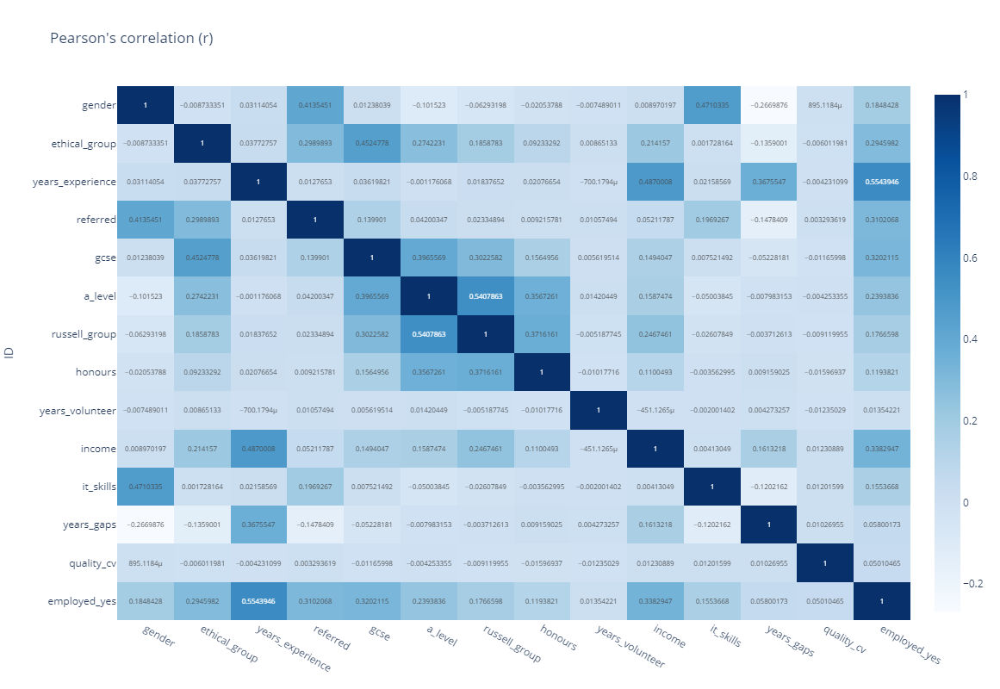

In [35]:
# Evaluate correlation of features and protected attributes
# Avoid usage of intercorrelated indicators, e.g. correlate numerical columns
df_train_corr = df_train.cast({"gender":"INT", "employed_yes":"INT", "ethical_group":"INT"})

from hana_ml.visualizers.eda import EDAVisualizer
eda = EDAVisualizer(enable_plotly=True) 
fig, corr = eda.correlation_plot(data=df_train_corr.drop('ID'), aspect='auto', text_auto=True, width=800, height=800) 
fig.show() 

Although in the data generation process, all 11 variables are related to the two sensitive variables, the values in the first two rows reveal that ~none of these 11 variables have a __moderate correlation__ (correlation coefficient sign. > 0.4) with the __two sensitive variables__. 

However, it is important to note that in the real world, __income__ is often reported and considered to have differences across __genders__ ("gender pay gap") and is typically correlated with __age__, another sensitive attribute. In the data generation process, we introduced an 8% difference between male and female groups for income.
<br>Therefore, in this case, we consider __income__ as a __proxy attribute__ and will __exclude__ it from the subsequent model training.

Furthermore, it should be acknowledged that in real-world scenarios, if the relationship between proxy attributes and sensitive attributes is hidden and cannot be identified and removed from the data preprocessing, bias in the data may still be present in the model.

In [36]:
# define sensitive attributes and proxy attribute
sen_vars = ['gender', 'ethical_group']
proxy_vars = ['income']
excluded_features = sen_vars + proxy_vars
print(excluded_features)

# exclude sensitvie variables - 'gender' and 'ethical_group' and their proxy attributes - 'income' in the training set and testing set
hdf_train_fair = df_train.deselect(excluded_features)
hdf_test_fair = df_test.deselect(excluded_features)
print(hdf_train_fair.columns)

['gender', 'ethical_group', 'income']
['ID', 'years_experience', 'referred', 'gcse', 'a_level', 'russell_group', 'honours', 'years_volunteer', 'it_skills', 'years_gaps', 'quality_cv', 'employed_yes']


### Explore the recruiting data regarding bias

__Fairness objective__
When discussing fairness in AI systems, the first step is to understand the potential harms that the system may cause and how to identify them. In the case of this recruitment scenario, our __fairness focus__ will be on __whether different groups of people have similar selection rates__ (demographic parity).

To illustrate this, the figures below displays the __selection rates__ of groups for sensitive variables - 'gender' and 'ethical_group'. 
<br>The selection rate refers to the proportion of individuals who received a job offer out of the total number of individuals in each group.

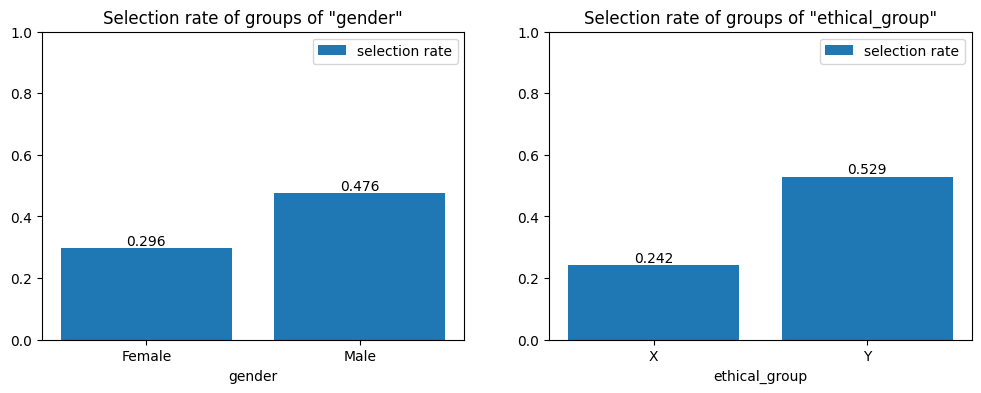

In [37]:
# to get the selection rate of different groups for two sensitive variables
from demo_funcs import plot_selection_rate    
plot_selection_rate(data=df_train, vars=['gender','ethical_group'], label='employed_yes', x_label = [["Female", "Male"], ["X", "Y"]])

The figure in the left reveals the selection rate for job offers between two gender groups - (1: male) and (0: female). In the __training data__,  a __significant disparity__ exists between the two groups, with men receiving job offers at a rate of 43.2%, while women are only offered jobs at a rate of 27.4%. 

Similarly, the figure in the right indicates that there is a noticeable disparity between the selection rates of two ethical groups (0: ethical group X, 1: ethical group Y). Ethical group Y has a selection rate of 47.3%, which is approximately twice as high as that of ethical group X, which has a selection rate of 23.6%. 

# 2. Building Machine Learning Classification Models

## Training a "regular" PAL HGBT model

Firstly, we will train a fairness-unaware model, a 'regular' Hybrid Gradient Boosting Tree (HGBT) model. We are using the Unified Classification method and apply cross-validation and hyperparameter grid search to achieve an optimal model regarding statistical model quality. 

In [39]:
# Reflecting the attributes used for training the model
hdf_train_fair.columns

['ID',
 'years_experience',
 'referred',
 'gcse',
 'a_level',
 'russell_group',
 'honours',
 'years_volunteer',
 'it_skills',
 'years_gaps',
 'quality_cv',
 'employed_yes']

In [40]:
# Training a HGBT model with cross-validation and hyperparameter grid search
from hana_ml.algorithms.pal.unified_classification import UnifiedClassification
import timeit
uhgc = UnifiedClassification(func='HybridGradientBoostingTree',
                             random_state = 2024,
                             fold_num = 5,
                             resampling_method='cv',
                             param_search_strategy='grid',                             
                             evaluation_metric='error_rate',
                             ref_metric=['auc'],
                             param_values={'learning_rate': [0.01, 0.1, 0.4, 0.7],
                                            'n_estimators': [30, 50, 70],
                                            'max_depth': [5, 10, 15],
                                            'split_threshold': [0.1, 0.4, 0.7]}) 
start_time = timeit.default_timer()
uhgc.fit(data=hdf_train_fair,  # in hdf_train_fair, sensitive variables and proxy attribute have been excluded.
         key= 'ID',
         label='employed_yes',
         partition_method='stratified',
         partition_random_state=1,
         stratified_column='employed_yes',
         ntiles=20, 
         build_report=True)
total_time = timeit.default_timer() - start_time
print("Runtime is: {}s".format(total_time))

Runtime is: 47.86847069999931s


In [42]:
# Capture optimal parameters from HGBT hyperparameter grid search
optimal = uhgc.optimal_param_.collect()
display(optimal)
N_ESTIMATORS = optimal.iat[0,1]
MAX_DEPTH = optimal.iat[1,1]
LEARNING_RATE = optimal.iat[2,2]
SPLIT_THRESHOLD = optimal.iat[3,2]
#print(N_ESTIMATORS, MAX_DEPTH, LEARNING_RATE, SPLIT_THRESHOLD)

,PARAM_NAME,INT_VALUE,DOUBLE_VALUE,STRING_VALUE
0,N_ESTIMATORS,30.0,NaN,None
1,MAX_DEPTH,5.0,NaN,None
2,LEARNING_RATE,NaN,0.4,None
3,SPLIT_THRESHOLD,NaN,0.7,None


<br><br>
__Evaluate model generalization__ using the __test data samples__ (data not used during training) and the __score-function__

In [43]:
# Review test datasample
#hdf_test_fair.head(3).collect()

In [44]:
# Test model generalization using the hdf_test_fair (data not used during training) and the SCORE-functions
# in hdf_test_fair, sensitive variables and proxy attribute have been excluded.
scorepredictions, scorestats, scorecm, scoremetrics =uhgc.score(data=hdf_test_fair, key='ID', label='employed_yes', 
                                                                ntiles=20, impute=True, thread_ratio=1.0, top_k_attributions=20)

In [45]:
# Show test data sample prediction incl. Reason_Code (local prediction explainability, defaults to tree-shap-values)
import pandas as pd
pd.set_option('max_colwidth', None)
scorepredictions.head(3).collect()

,ID,SCORE,CONFIDENCE,REASON_CODE
0,0,1,0.664566,"[{""attr"":""years_experience"",""val"":-2.814102913172691,""pct"":43.962230297094347},{""attr"":""referred"",""val"":1.133550033488339,""pct"":17.708445342288475},{""attr"":""gcse"",""val"":-0.9526926170283219,""pct"":14.883070564367247},{""attr"":""years_gaps"",""val"":0.9222571586029521,""pct"":14.407604430477623},{""attr"":""it_skills"",""val"":-0.20629443723722547,""pct"":3.222754760097802},{""attr"":""honours"",""val"":0.12668089967831254,""pct"":1.9790231763849218},{""attr"":""a_level"",""val"":0.0957192728404585,""pct"":1.4953371807352996},{""attr"":""russell_group"",""val"":0.07337236375494616,""pct"":1.1462312688488295},{""attr"":""quality_cv"",""val"":-0.07018875573243709,""pct"":1.0964965884268446},{""attr"":""years_volunteer"",""val"":0.006324778148381166,""pct"":0.09880639127859067}]"
1,1,1,0.629484,"[{""attr"":""years_experience"",""val"":-2.175099169068209,""pct"":41.68883637619949},{""attr"":""referred"",""val"":-1.1374942936051487,""pct"":21.801678819674355},{""attr"":""gcse"",""val"":0.5735743981229392,""pct"":10.99336047430326},{""attr"":""a_level"",""val"":0.5624758222160742,""pct"":10.780640649124745},{""attr"":""years_gaps"",""val"":0.4819722346421374,""pct"":9.237676108567904},{""attr"":""it_skills"",""val"":0.19636244258931769,""pct"":3.7635625335849784},{""attr"":""russell_group"",""val"":-0.05489340042429223,""pct"":1.0521092651613969},{""attr"":""years_volunteer"",""val"":0.015227527789116333,""pct"":0.2918569982657165},{""attr"":""honours"",""val"":0.013284004138925953,""pct"":0.25460663258203578},{""attr"":""quality_cv"",""val"":-0.007078642393205046,""pct"":0.13567214253609065}]"
2,2,0,0.910604,"[{""attr"":""referred"",""val"":1.3274551162072892,""pct"":32.17025221684388},{""attr"":""years_experience"",""val"":0.983465995156242,""pct"":23.833837185592019},{""attr"":""a_level"",""val"":-0.9280409335548345,""pct"":22.490636809864247},{""attr"":""gcse"",""val"":0.2905467720184245,""pct"":7.04126476481407},{""attr"":""years_gaps"",""val"":-0.21145618845850534,""pct"":5.124541562624349},{""attr"":""it_skills"",""val"":-0.18914500277278016,""pct"":4.583840440602733},{""attr"":""honours"",""val"":0.10828845568937672,""pct"":2.624319940589071},{""attr"":""russell_group"",""val"":-0.06561556556278713,""pct"":1.5901624602847165},{""attr"":""years_volunteer"",""val"":0.013098368196598981,""pct"":0.3174328106230865},{""attr"":""quality_cv"",""val"":-0.009231117689060478,""pct"":0.22371180816185994}]"


<br></br>
### Debrief the "regular" HGBT model


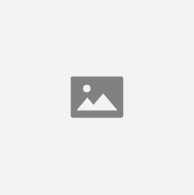

In [46]:
# Create a classification model report
from hana_ml.visualizers.unified_report import UnifiedReport
UnifiedReport(uhgc).build().display()

In the ___model report above__, the model’s various performances during training and scoring can be observed. For instance, in both the 'Statistic' and 'Scoring Statistic' pages, the model demonstrates __high values for metrics__ such as AUC (Area Under the Curve) and Accuracy, high precision and recall for Class 0 and relatively good precision and recall for Class 1. This indicates that the trained HGBT model is __performing reasonably well__.
<br></br>

### Explore feature impacts using SHAP reports


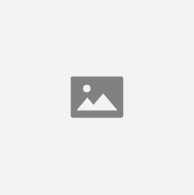

In [52]:
# Exploring direct feature effect using shapley plots 
features = hdf_test_fair.columns
#print(features)
features.remove('ID')
features.remove('employed_yes')

from hana_ml.visualizers.shap import ShapleyExplainer
shapley_explainer = ShapleyExplainer(reason_code_data=scorepredictions.sort("ID").select('REASON_CODE'), 
                                     feature_data=hdf_test_fair.sort("ID").select(features))
shapley_explainer.summary_plot()

In this __SHAP summary report__, the __contribution of different features to the prediction__ can be observed in the __beeswarm plot__.
<br> The top three variables that have the most significant impact on the prediction are 'years_experience', 'referred', and 'gcse'. 
<br> Taking 'years_experience' as an example, red signifies a longer work experience while blue indicates a shorter one. Since the blue falls in the negative value region and the red is distributed in the positive value region. This suggests that the longer the work experience, the more likely one is to receive a job offer. This trend is consistent with the settings during the dataset construction. 
<br> Similarly, consistent results can be observed in the ‘years_experience’ graph in the dependence plot.

In [56]:
# The SHAP force plot, visualizes the shapley-values (extracted from the REASON_CODE) for each individual prediction
shapley_localexplainer = ShapleyExplainer(reason_code_data=scorepredictions.sort("ID").head(10).select('REASON_CODE'), 
                                     feature_data=hdf_test_fair.sort("ID").head(10).select(features))
shapley_localexplainer.force_plot()

<br></br>

### Visualize confusion matrices

Next, we will continue to explore the overall confusion matrix and the confusion matrices for different groups.

<Axes: xlabel='True label', ylabel='Predicted label'>

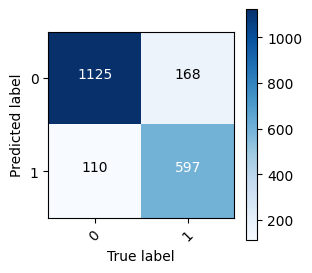

In [57]:
import matplotlib.pyplot as plt
from hana_ml.visualizers.metrics import MetricsVisualizer
plt.figure(figsize=(3,3))
mv = MetricsVisualizer(enable_plotly=False)
mv.plot_confusion_matrix(scorecm, normalize=False)

The following confusion matrices for the scorepredictions obtained based on different sensitive vars - 'gender' and 'ethical_group', are presented. The third confusion matrix represents the differences between the non-normalized values of the first and the second confusion matrices.

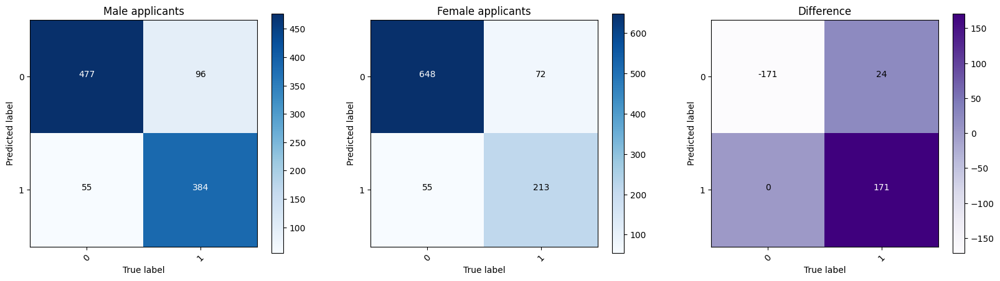

In [58]:
from demo_funcs import cm_compare
cm_compare(original_data=df_test, score_predictions=scorepredictions, 
           sensitive_variable='gender', label='employed_yes', title={"0":"Female", "1":"Male"})

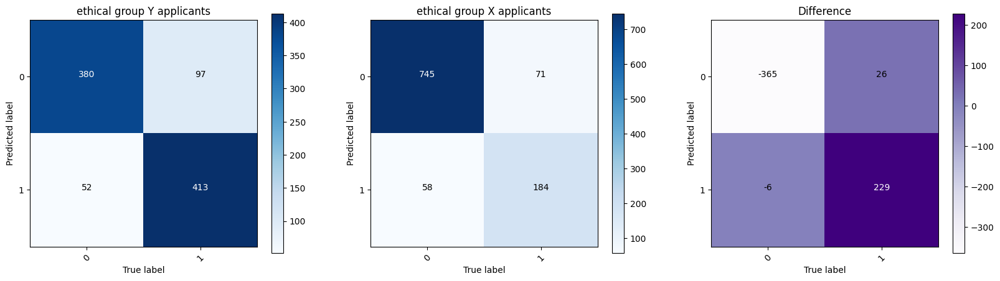

In [59]:
cm_compare(original_data=df_test, score_predictions=scorepredictions, 
           sensitive_variable='ethical_group', label='employed_yes', title={"0":"ethical group X", "1":"ethical group Y"})

From the above confusion matrix, it can be seen that the True Positives and True Negatives are relatively larger compared to False Positives and False Negatives. This demonstrates that the model’s predictive accuracy is high for different groups. 

### Explore model metrics regarding fairness

In the following plots, we display and compare various metrics of scorepredictions concerning sensitive variables and thus groups of applicants.

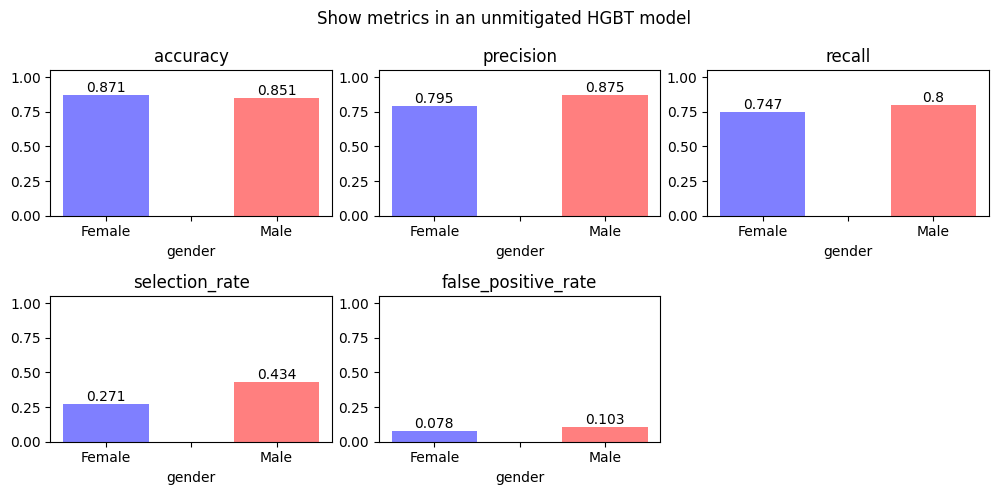

In [61]:
from demo_funcs import plot_metric_comparision_by_var
res_Female, res_Male = plot_metric_comparision_by_var(true_data=df_test, predict_data=scorepredictions, 
                                                      sensitive_variable='gender', group_names=['0', '1'], 
                                                      key='ID', label='employed_yes', positive_label='1', negative_label='0', 
                                                      title="Show metrics in an unmitigated HGBT model", x_label=['Female', 'Male'])

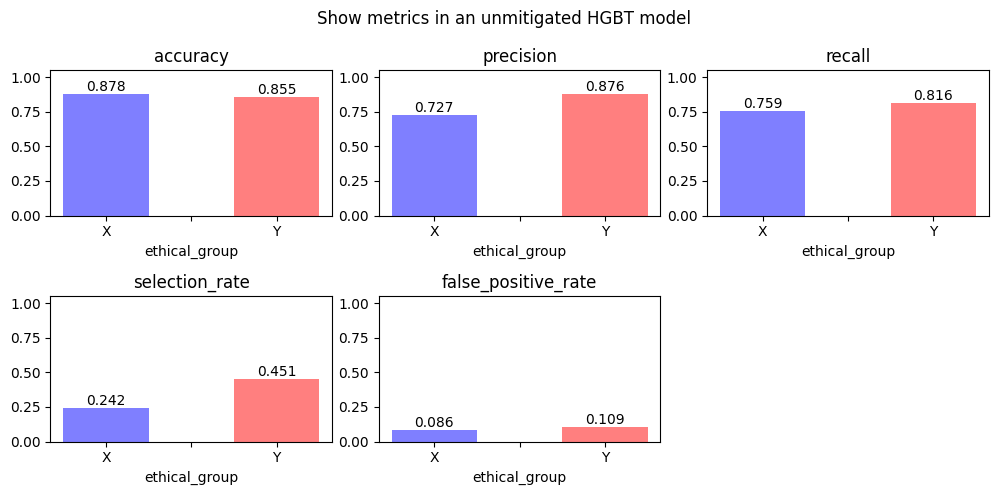

In [23]:
res_ethical_group_X, res_ethical_group_Y = plot_metric_comparision_by_var(true_data=df_test, predict_data=scorepredictions, 
                                                                          sensitive_variable='ethical_group', group_names=['0', '1'], 
                                                                          key='ID', label='employed_yes', positive_label='1', negative_label='0', 
                                                                          title="Show metrics in an unmitigated HGBT model", x_label=['X', 'Y'])

In the two diagrams showcased, the model’s accuracy for both categories is high (>80%). 
<br> A __substantial difference__ in the __selection rate__ exists among __males and females__ as well as betweem __ethical groups__, with men and ethical group Y demonstrating a higher selection rate. 
<br> This __disparity__ is expected, as such patterns have already been observed in the dataset.

## Training a FairML PAL HGBT model with demographic_parity

Now, in order to __mitigate the bias observed__ and __counter the perpetuation or amplification__ of the __existing demographic disparities__ we have chosen to apply the PAL FairML function to build a fairer recruitment proposal model.
<br> We __aim__ to __achieve similar selection rates across various demographic groups__. To reach this goal, we configure __'demographic_parity'__ as the designation for the 'fair_constraint' parameter. Of particular interest is the use of the parameter __'fair_exclude_sensitive_variable'__, which indicates while the sensitive attribute(s) is used to control the fairness condition, it is not used as part of the actual model and thus not used when the model is applied for predictions. Note, the proxy attribute 'income' is exlcuded in both training set and testing set.

In [63]:
from hana_ml.algorithms.pal.fair_ml import FairMLClassification

print(sen_vars)
print(proxy_vars)

hgbt_params = dict(n_estimators = int(N_ESTIMATORS), split_threshold=SPLIT_THRESHOLD,
                   learning_rate=LEARNING_RATE, max_depth=int(MAX_DEPTH), random_state=1234)
hgbt_fm = FairMLClassification(fair_submodel='hgbt',
                               fair_constraint="demographic_parity",
                               fair_exclude_sensitive_variable=True, ### exclude sensitive attributes from model                                                          
                               **hgbt_params)
hgbt_fm.fit(data=df_train.deselect(proxy_vars), ### data with sensitive attributes, but without proxy variables
            key='ID', 
            label='employed_yes', 
            fair_sensitive_variable=sen_vars) ### indicate which attribute is sensitive and is used to build up fairness condition upon them
hgbt_fm.runtime

['gender', 'ethical_group']
['income']


6.654853582382202

Use the new FairML-model to make predictions and obtain the results.

In [64]:
# Show predicted values from the FairML-model, exlcude sensitive, proxy_attribute and label
print(excluded_features)
result_fml = hgbt_fm.predict(df_test.deselect(excluded_features+["employed_yes"]), key='ID')
result_fml.head(2).collect()

['gender', 'ethical_group', 'income']


,ID,SCORE
0,200,1
1,201,0


### Visualize confusion matrices
Visualize confusion matrices across sensitive groups

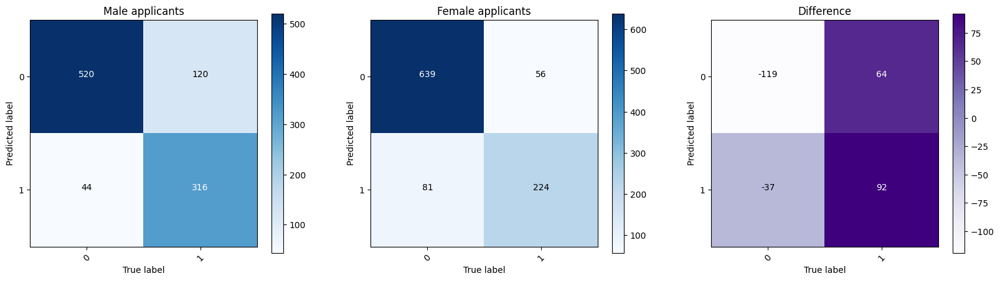

In [26]:
cm_compare(original_data=df_test, score_predictions=result_fml, 
           sensitive_variable='gender', label='employed_yes', title={"0":"Female", "1":"Male"})

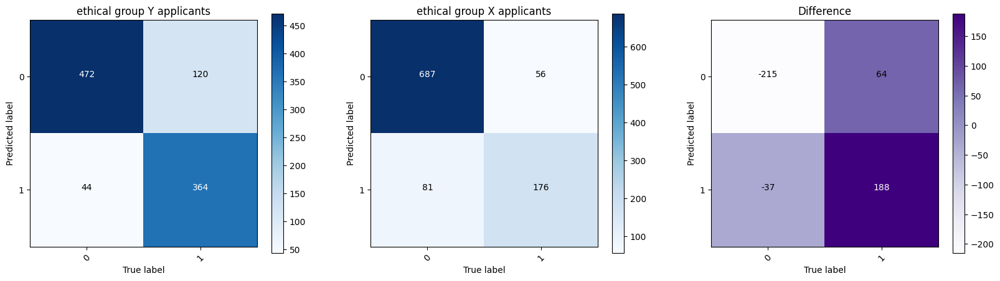

In [27]:
cm_compare(original_data=df_test, score_predictions=result_fml, 
           sensitive_variable='ethical_group', label='employed_yes', title={"0":"ethical group X", "1":"ethical group Y"})

### Explore model metrics regarding fairness

Then, show the comparsion of metrics of FairML-HGBT model for different demographic groups.

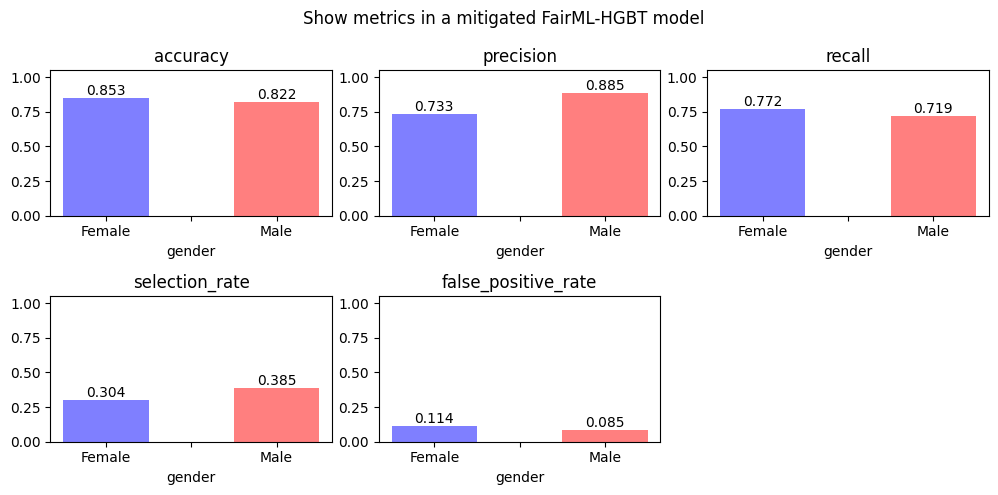

In [65]:
res_fml_Female, res_fml_Male = plot_metric_comparision_by_var(true_data=df_test, predict_data=result_fml, 
                                                              sensitive_variable='gender', group_names=['0', '1'], 
                                                              key='ID', label='employed_yes', positive_label='1', negative_label='0', 
                                                              title="Show metrics in a mitigated FairML-HGBT model", x_label=['Female', 'Male'])

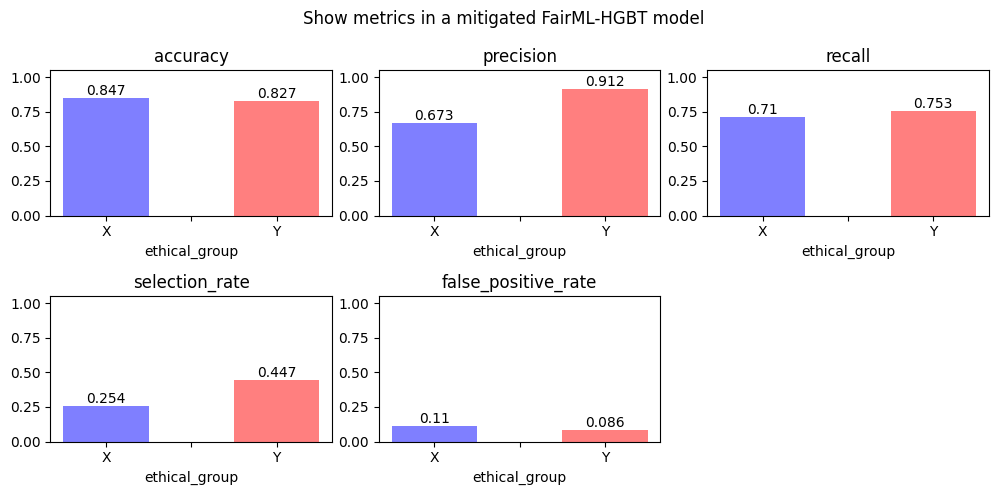

In [66]:
res_fml_ethical_group_X, res_fml_ethical_group_Y = plot_metric_comparision_by_var(true_data=df_test, predict_data=result_fml, 
                                                  sensitive_variable='ethical_group', group_names=['0', '1'], 
                                                  key='ID', label='employed_yes', positive_label='1', negative_label='0', 
                                                  title="Show metrics in a mitigated FairML-HGBT model", x_label=['X', 'Y'])

## Comparing model metrics of both models

In this section, we aim to compare the performance of two models - a regular HGBT model and the FairML-HGBT model in terms of __accuracy__ and __selection rate__ on the testing dataset. This comparison will provide a more intuitive understanding of how the FairML-HGBT model addresses fairness concerns while maintaining model performance.

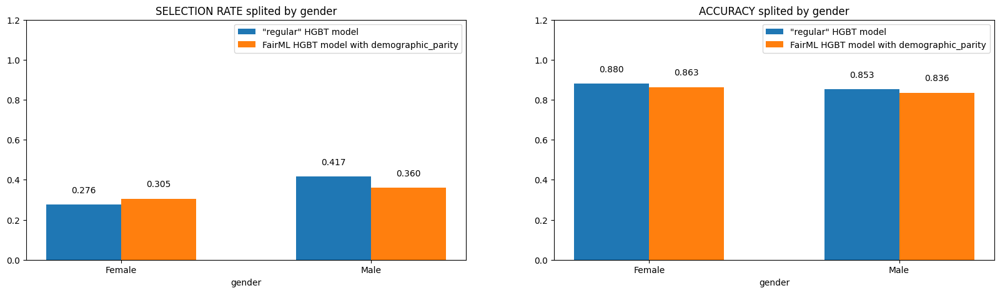

In [30]:
from demo_funcs import model_comparison_plot   
model_comparison_plot(metrics=['SELECTION RATE', 'ACCURACY'], 
                      dict_0=res_Female, 
                      dict_0_fm=res_fml_Female, 
                      dict_1=res_Male, 
                      dict_1_fm=res_fml_Male, 
                      variable='gender',
                      x_label=['Female', 'Male'])

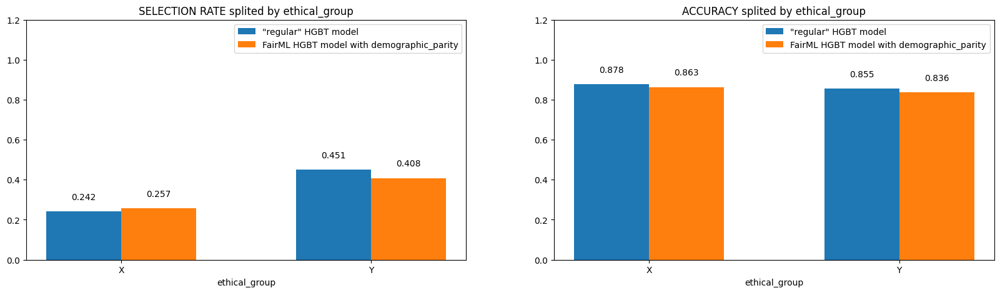

In [31]:
model_comparison_plot(metrics=['SELECTION RATE', 'ACCURACY'], 
                      dict_0=res_ethical_group_X, 
                      dict_0_fm=res_fml_ethical_group_X, 
                      dict_1=res_ethical_group_Y, 
                      dict_1_fm=res_fml_ethical_group_Y, 
                      variable='ethical_group',
                      x_label=['X', 'Y'])

By using the __FairML__ approach, we can clearly observe a __reduction in the disparity of selection rates between different groups__. For example, the selection rate for men has decreased, and the selection rate for women has increased. It is expected that the FairML-HGBT model may experience a __slight decrease in accuracy__ when compared to the regular HGBT model. 

# 3. Conclusion and Disclaimer

In this [blog](https://blogs.sap.com/2023/12/08/fairness-in-machine-learning-a-new-feature-in-sap-hana-pal/), we introduced the newly provided [FairML function](https://help.sap.com/docs/hana-cloud-database/sap-hana-cloud-sap-hana-database-predictive-analysis-library/fair-ml?locale=en-US) with  SAP HANA Cloud Predictive Analysis Library (PAL) in 2023 Q4. Using synthetic recruiting data, we demonstrated how the SAP HANA FairML approach can be used to mitigate bias in a machine learning model, thereby promoting a more equitable AI environment.

It is essential to differentiate the notions of unfairness in the machine learning field from discrimination under laws and regulations. It is important to note that while unfairness in machine learning can contribute to discriminatory outcomes. While such discriminatory outcomes of an AI system might not necessarily be considered as illegal discrimination under applicable laws and regulation, however from an ethical and responsible AI perspective (or company policy) it might still be regarded unacceptable. Therefore, caution should be exercised, and compliance with applicable laws and regulations is crucial, as improper usage may unintentionally result in discriminatory outcomes.

The FairML function assists with data analysis and prediction but has limitations, relying on the quality and completeness of data inputs. Although efforts have been made to reduce bias and promote fairness, achieving a 100% elimination of bias is not possible. Consequently, the function’s outputs may still reflect varying degrees of inequality. The application of any mitigation function may further also introduce new negative effects impacting other minority groups or individuals. It is important not to solely rely on this tool for critical decision-making or as the sole determinant of conclusions.

Users are responsible for verifying results and ensuring that decisions made from the function comply with local laws and regulations. Caution should be exercised when using the function, which should supplement, rather than replace, human judgment, particularly in cases involving personal, legal, or ethical implications. Creators or providers of this function do not assume liability for misunderstandings, misapplications, or misinterpretations resulting from its usage, nor for any harm, damage, or losses incurred. In conclusion, we advise caution and skepticism when interpreting results and verifying information in critical matters.

# Appendix

##  A) Synthetic recruiting data

Constructs a synthetic recruiting data set that we will use for exploring fairness interventions.

In [4]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

We suppose that a large company has historical records of people that have applied to join the company, and whether or not that candidate was subsequently employed. We will use this data to train a model to predict whether individuals should be employed or not. A discussion of whether this is appropriate and how to mitigate potential biases is contained in the app.

We aim to generate data in such a way that each of the features reflects certain unfair biases, as do the actual labels themselves. Biases in the features such as the level of education attained reflect systemic biases, whereas bias in the labels reflects historical biases in the hiring practices of the company.

We have settled on the following features as ones that might be relevant in an automated recruitment setting.

- 'referred' : Did the candidate get referred for this position?
- 'years_experience' : Number of career years relevant to the job
- 'russell_group' : Did the candidate attend a Russell Group university
- 'honours' : Did the candidate graduate with an honours degree
- 'gcse' : GCSE results
- 'a_level' : A-level results
- 'income' : Current income
- 'gender' : Femail and male
- 'ethical_group' : Two Ethic groups
- 'quality_cv' : Quality of written CV
- 'years_volunteer' : Years of volunteering experience
- 'years_gaps' : Years of gaps in the CV
- 'it_skills' : Level of IT skills
- 'employed_yes' : Whether employed or not (target variable)

We start by defining some high-level parameters that will control the data generation.

In [5]:
N = 10000  # number of data points to generate
P_GENDER_MALE = 0.5 # pencentage of male 50%
P_ETHICAL_GROUP_X = 0.5 # pencentage of ethical group X 50%

In [6]:
df = pd.DataFrame()
df["gender"] = np.random.binomial(1, P_GENDER_MALE, N) # 1 : male, 0 : female
df["ethical_group"] = np.random.binomial(1, P_ETHICAL_GROUP_X, N) #  1 : ethical group Y,  0 : ethical group X
# we won't use age in the final data, we just use it to ensure other features like years of experience are generated consistently
df["age"] = np.floor(np.random.poisson(70, N) / 2)

We assume that on average individuals have spent half of the time they've been of working age accumulating relevant experience. We sample from the Poisson distribution with this mean.

In [7]:
df["years_experience"] = np.random.poisson(
    0.4 * np.where(df.age >= 22, df.age - 22, 0)
    + df.ethical_group * 0.2  # adjustest for ethical group Y
    + df.gender * 0.1 # adjusted for male
)

Binary variable stating whether the applicant has been referred or not. We assume men are more likely to be referred than women, and  ethical group Y people are more likely to be referred than ethical group X people.

In [8]:
df["referred"] = np.random.binomial(
    1, 0.2 + 0.35 * df.gender + 0.3 * df.ethical_group # # adjusted for male and ethical group Y
)

We model the number of GCSEs better than C grade as a binomial distribution with 10 trials. The increased probability of good grades for ethical_group_A students is intended to reflect systemic biases in access to education.

In [9]:
df["gcse"] = np.random.binomial(10, 0.6 + df.ethical_group * 0.1) # adjusted for ethical group Y

A level results are mostly determined by GCSE results.

In [10]:
a_level_prob = (
    0.4  # baseline probability
    + df.gcse / 20  # adjusted for gcse results
    + df.ethical_group * 0.05  # adjustest for ethical group Y
    - df.gender * 0.05  # adjusted for male
)

df["a_level"] = np.random.binomial(4, a_level_prob)

Sample binary variable indicating whether individual went to a Russell Group Univeristy. Influenced mainly by A-levels and GCSEs

In [11]:
def russell_group_prob(row):
    if row.a_level == 4:
        return 0.8
    elif row.a_level == 3 and row.gcse >= 7:
        return 0.4
    return 0.1
df["russell_group"] = np.random.binomial(
    1, df.apply(russell_group_prob, axis=1)
)

Honours degree depends both on a-levels and Russell Group attendance.

In [12]:
def honours_prob(row):
    if row.russell_group == 1:
        return 0.9
    return 0.2 + 0.15 * row.a_level

df["honours"] = np.random.binomial(1, df.apply(honours_prob, axis=1))

Years of voluntary experience.

In [13]:
df["years_volunteer"] = np.random.poisson(0.5, N)

Current income

In [14]:
def salary_mean(row):
    gender_adjust = 1 + 0.08 * row.gender
    return (
        (15000 + row.russell_group * 3000 + row.ethical_group * 2000 + np.sqrt(row.years_experience) * 5000) * gender_adjust
    )

def salary_std(row):
    return 1000 + np.sqrt(row.years_experience) * 2000

# integer divide and multiply by 250 to round to nearest 250
df["income"] = (
    np.random.normal(
        df.apply(salary_mean, axis=1), df.apply(salary_std, axis=1),
    )
    // 250
    * 250
)

IT skills is a simple ordered categorical variable that depends on gender.

In [15]:
df["it_skills"] = np.random.binomial(3, 0.4 + 0.2 * df.gender) # adjusted for male

Years of gaps in cv

In [16]:
df["years_gaps"] = np.random.poisson(
    0.2
    * (1.0 - 0.5 * df.gender - 0.25 * df.ethical_group) # adjusted for male and ethical group Y
    * df.years_experience
)

Quality of written cv

In [17]:
df["quality_cv"] = np.random.binomial(3, 0.6, N)

Finally we use a logistic regression to create a probability that the individual was employed, then sample a label with that probability.

In [18]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

def employed_prob(row):
    return sigmoid(
        # implicit discrimination
        2 * row.referred
        + 1 * row.years_experience
        + 0.5 * row.gcse
        + 0.8 * row.a_level
        + 0.1 * row.russell_group
        + 0.1 * row.honours
        - 0.5 * row.years_gaps
        + 0.4 * row.quality_cv
        + 0.4 * row.it_skills
        # explicit discrimination
        + 0.8 * row.ethical_group
        + 0.5 * row.gender
        # offset
        - 15
    )

df["employed_yes"] = np.random.binomial(1, df.apply(employed_prob, axis=1))

In [19]:
# Drop age as it's no longer needed.
df = df.drop(columns="age")

The final data looks like this.

In [20]:
df.head()

,gender,ethical_group,years_experience,referred,gcse,a_level,russell_group,honours,years_volunteer,income,it_skills,years_gaps,quality_cv,employed_yes
0,1,1,6,1,8,3,0,1,0,28500.0,1,0,2,1
1,0,0,3,1,8,3,1,1,0,30750.0,2,1,1,0
2,1,1,2,0,8,4,1,1,0,27750.0,2,0,1,0
3,1,0,6,0,8,2,0,0,0,27500.0,3,2,3,0
4,1,1,2,1,6,4,0,1,2,27000.0,2,0,2,1


### Train, val and test splits

We split the data into train, validation and test sets.

In [21]:
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)
train_df.insert(0, 'ID', range(len(train_df)))
test_df.insert(0, 'ID', range(len(test_df)))
#print(train_df.head(3))
#print(test_df.head(3))

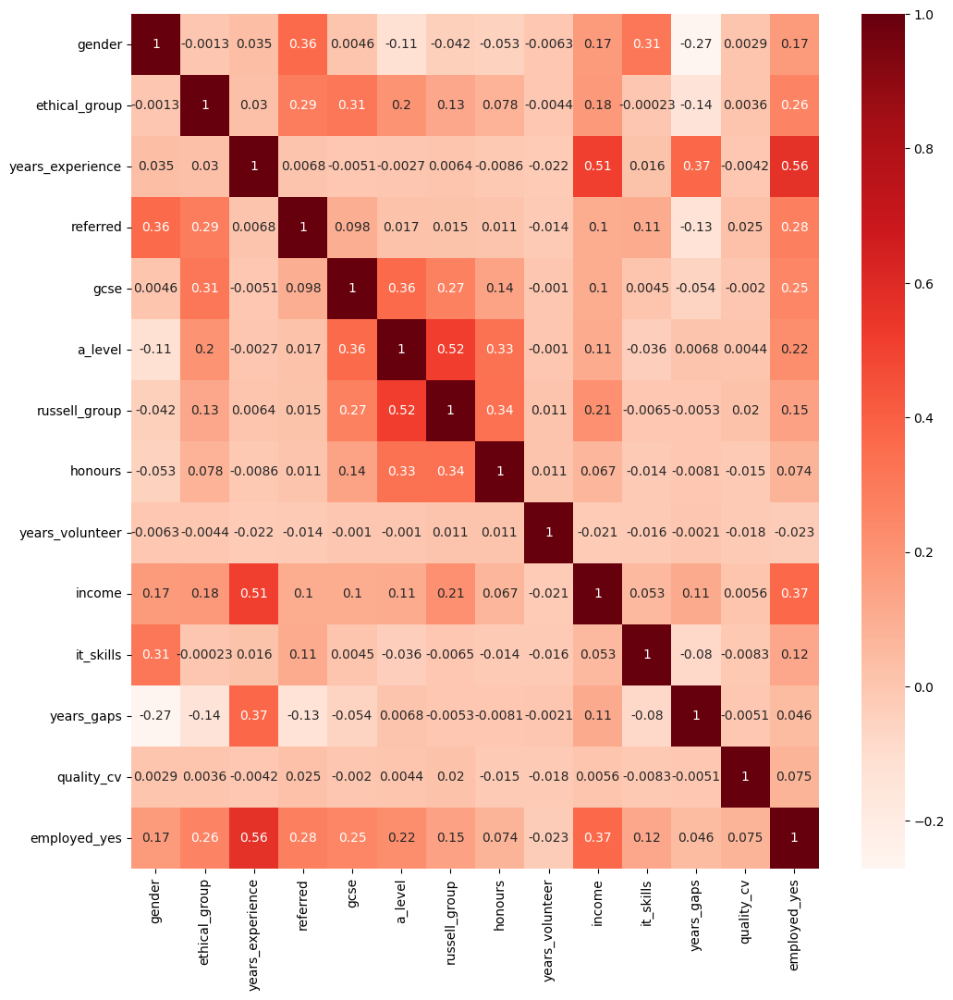

In [22]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
correlation_matrix = train_df.iloc[:, 1:].corr()
plt.figure(figsize=(12,12))
sns.heatmap(correlation_matrix, annot=True, cmap=plt.cm.Reds)
plt.show()

In [23]:
average_income_by_gender = train_df.groupby('gender')['income'].mean()
print(average_income_by_gender)

gender
0    27872.636816
1    30271.231156
Name: income, dtype: float64


### Save data to csv

Data generated by us is committed to the repository for reproducibility. However feel free to regenerate your own version of the data and compare results.

## B) Loading utility python functions

In order to sustain better readability of this demo jupyter notebook, a couple of python functions have been defined in the file "demo_funcs.py". 
<br> Please ensure the file locates in the same directory as this <notebook>.ipynb-file.
<br> The functions are loaded first with "from demo_funcs import plot_selection_rate"